# PANDAS
Pandas is a python library used for manipulating tabular data. Also, allowing SQL-eqsue queries to get results out of the data and helps us to perform some data visualisation as well. Mainly used for data cleaning and handling time-series data. 
- `pip install pandas` is used to install pandas
- The most familiar term used with Pandas is dataframe. The best way to think of Pandas is to consider it as a very powerful version of Excel, and a dataframe is like a spreadsheet
- Pandas dataframes are organized in 2 dimensions - Rows and Columns. Pandas DataFrames are extremely useful for analyzing data

 

## PANDAS Practical 1:
- Pandas doesn't have a specific method for reading YAML files
- However, you can use pandas to parse a JSON object or file
- Create a function that transforms a yaml file into a pandas DataFrame
- Use this file to test your function

In [41]:
import yaml
import pandas as pd
#df stands for data_frame
with open('C:\\Users\\Anany\\OneDrive\\Desktop\\Github\\AIcore\\aicore_pathways\\data_cleaning_with_pandas\\yaml_example.yaml','r') as file:
    data = yaml.safe_load(file)

df_yaml = pd.DataFrame(data["Person"])
df_yaml

,name,surname,role,age
0,Alex,Brown,Student,20
1,Chris,Davis,Instructor,31
2,Emma,Green,Student,22
3,John,King,Admin,27
4,Lucy,Miller,Admin,24
5,Nick,Oliver,Professor,45
6,Paul,Quinn,Assistant,19


- Use the Salaries.csv file calculate:
- What is the ratio between people in the fire department over people in the police department
- What is the mean salary of the police department? Use the "BasePay" column.
- What is the mean salary of the fire department? Use the "BasePay" column.

In [22]:
df = pd.read_csv('salaries.csv')
df

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status
0,AA,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN
3,AD,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.00,56120.71,198306.90,NaN,332343.61,332343.61,2011,NaN,San Francisco,NaN
4,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
671,ZV,CHERYL ADAMS,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.18,0.00,3537.89,NaN,180394.07,180394.07,2011,NaN,San Francisco,NaN
672,ZW,LOUISE SIMPSON,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.18,0.00,3537.80,NaN,180393.98,180393.98,2011,NaN,San Francisco,NaN
673,ZX,BLAKE LOEBS,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.19,0.00,3537.75,NaN,180393.94,180393.94,2011,NaN,San Francisco,NaN
674,ZY,ELIZABETH AGUILAR-TARCHI,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.17,0.00,3537.11,NaN,180393.28,180393.28,2011,NaN,San Francisco,NaN


In [37]:
#ratio between people in the fire department over people in the police department 
fire_personnel = df['JobTitle'].str.contains("FIRE DEPARTMENT").sum()
police_personnel = df['JobTitle'].str.contains("POLICE DEPARTMENT").sum()
print(f"the raio between fire and police department is {fire_personnel/police_personnel}")

#mean salary of the departments 
fire_personnel_df = df[df['JobTitle'].str.contains("FIRE DEPARTMENT")]
avg_fire_salary = fire_personnel_df['BasePay'].mean()
police_personnel_df = df[df['JobTitle'].str.contains("POLICE DEPARTMENT")]
avg_police_salary = police_personnel_df['BasePay'].mean()
print(f"The average salary of fire and police respectively is {avg_fire_salary},{avg_police_salary}")

the raio between fire and police department is 0.7586206896551724
The average salary of fire and police respectively is 144449.87079545454,151947.28689655173


### NOTES
For JSON, CSV and mainstream files, we can read them to dataframes and write them from dataframes easily 

- `df = pd.read_csv('salaries.csv)`
- `df.to_csv('salaries.csv', index=False)`
- `df.to_json('salaries.json')`
- `df.to_excel('salaries.xlsx')`

However for YAML files, I've demonstrated above on how to read them but to write them we need to use the safe_dump option

- First, let's convert the dataframe to a dictionary

- `sample_dict = sample_df.to_dict()`

- Then, we can convert the dictionary to a yaml file

- `with open('sample.yaml', 'w') as f:`
     `yaml.dump(sample_dict, f)`

## PANDAS Practical 2
How many unique jobs are there? Look at the unique method in pandas


In [50]:
print(len(df['JobTitle'].unique()))
print(df['JobTitle'].unique())


93
['GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY'
 'CAPTAIN III (POLICE DEPARTMENT)' 'WIRE ROPE CABLE MAINTENANCE MECHANIC'
 'DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)'
 'ASSISTANT DEPUTY CHIEF II' 'BATTALION CHIEF, (FIRE DEPARTMENT)'
 'DEPUTY DIRECTOR OF INVESTMENTS' 'CHIEF OF DEPARTMENT, (FIRE DEPARTMENT)'
 'ASSISTANT CHIEF OF DEPARTMENT, (FIRE DEPARTMENT)'
 'EXECUTIVE CONTRACT EMPLOYEE' 'DEPARTMENT HEAD V'
 'COMMANDER III, (POLICE DEPARTMENT)'
 'CAPTAIN, EMERGENCYCY MEDICAL SERVICES' 'ASSISTANT MEDICAL EXAMINER'
 'CAPTAIN, FIRE SUPPRESSION' 'CHIEF OF POLICE'
 'DEPUTY CHIEF III (POLICE DEPARTMENT)'
 'INSPECTOR III, (POLICE DEPARTMENT)' 'ELECTRONIC MAINTENANCE TECHNICIAN'
 'ADMINISTRATOR, SFGH MEDICAL CENTER' 'LIEUTENANT III (POLICE DEPARTMENT)'
 'FIREFIGHTER' 'NURSING SUPERVISOR PSYCHIATRIC' 'MAYOR'
 'LIEUTENANT, FIRE DEPARTMENT' 'INCIDENT SUPPORT SPECIALIST' 'ANESTHETIST'
 'DISTRICT ATTORNEY' 'ELECTRICAL TRANSIT MECHANIC, ASSISTANT SUPERVISOR'
 'PORT DIRECTOR' 'LIEUTENANT, BUR

Count how many people have the first name "John"

In [56]:
count_john = df[df['EmployeeName'].str.startswith('JOHN')]['EmployeeName'].count()
print("Number of people with the first name John:", count_john)


Number of people with the first name John: 31


Find the surname of everyone whose first name is more than 6 characters long

In [58]:
# Split employeename into first and last name
df['FirstName'], df['LastName'] = df['EmployeeName'].str.split(' ', 1).str

df[df['LastName'].str.len() > 6]

C:\Users\Anany\AppData\Local\Temp\ipykernel_14804\2037996668.py:2: FutureWarning: In a future version of pandas all arguments of StringMethods.split except for the argument 'pat' will be keyword-only.
  df['FirstName'], df['LastName'] = df['EmployeeName'].str.split(' ', 1).str
C:\Users\Anany\AppData\Local\Temp\ipykernel_14804\2037996668.py:2: FutureWarning: Columnar iteration over characters will be deprecated in future releases.
  df['FirstName'], df['LastName'] = df['EmployeeName'].str.split(' ', 1).str


,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status,FirstName,LastName
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN,GARY,JIMENEZ
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN,ALBERT,PARDINI
4,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN,PATRICK,GARDNER
5,AF,DAVID SULLIVAN,ASSISTANT DEPUTY CHIEF II,118602.00,8601.00,189082.74,NaN,316285.74,316285.74,2011,NaN,San Francisco,NaN,DAVID,SULLIVAN
7,AH,DAVID KUSHNER,DEPUTY DIRECTOR OF INVESTMENTS,256576.96,0.00,51322.50,NaN,307899.46,307899.46,2011,NaN,San Francisco,NaN,DAVID,KUSHNER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
666,ZQ,SEAN CONNOLLY,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.18,0.00,3537.96,NaN,180394.14,180394.14,2011,NaN,San Francisco,NaN,SEAN,CONNOLLY
669,ZT,JOSHUA MILSTEIN,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.19,0.00,3537.94,NaN,180394.13,180394.13,2011,NaN,San Francisco,NaN,JOSHUA,MILSTEIN
670,ZU,ELIZABETH SALVESON,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.23,0.00,3537.86,NaN,180394.09,180394.09,2011,NaN,San Francisco,NaN,ELIZABETH,SALVESON
672,ZW,LOUISE SIMPSON,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.18,0.00,3537.80,NaN,180393.98,180393.98,2011,NaN,San Francisco,NaN,LOUISE,SIMPSON


Create a new column called "last_updated" where every value is equal to the current time (use the datetime module and format the date in ISO format).

In [66]:
import datetime
df['last_update'] = datetime.datetime.now().isoformat()
df.head()

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status,FirstName,LastName,last_update
0,AA,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN,NATHANIEL,FORD,2023-05-16T00:51:19.883748
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN,GARY,JIMENEZ,2023-05-16T00:51:19.883748
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN,ALBERT,PARDINI,2023-05-16T00:51:19.883748
3,AD,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.00,56120.71,198306.90,NaN,332343.61,332343.61,2011,NaN,San Francisco,NaN,CHRISTOPHER,CHONG,2023-05-16T00:51:19.883748
4,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN,PATRICK,GARDNER,2023-05-16T00:51:19.883748


Create a new derived column called "time_ratio" in the DataFrame which is the proportion of overtime pay to base pay

In [67]:
# Create the "time_ratio" column
df['time_ratio'] = df.apply(lambda row: row['OvertimePay'] / row['BasePay'] if row['BasePay'] != 0 else 0, axis=1)
df.head()

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status,FirstName,LastName,last_update,time_ratio
0,AA,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN,NATHANIEL,FORD,2023-05-16T00:51:19.883748,0.000000
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN,GARY,JIMENEZ,2023-05-16T00:51:19.883748,1.571701
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN,ALBERT,PARDINI,2023-05-16T00:51:19.883748,0.498677
3,AD,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.00,56120.71,198306.90,NaN,332343.61,332343.61,2011,NaN,San Francisco,NaN,CHRISTOPHER,CHONG,2023-05-16T00:51:19.883748,0.720272
4,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN,PATRICK,GARDNER,2023-05-16T00:51:19.883748,0.072447


In one line, create a new DataFrame called "new_df" which contains only people who earn more than 100K base salary


In [70]:
new_df = df[df['BasePay']>100000]
new_df.head()

,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status,FirstName,LastName,last_update,time_ratio
0,AA,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN,NATHANIEL,FORD,2023-05-16T00:51:19.883748,0.000000
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN,GARY,JIMENEZ,2023-05-16T00:51:19.883748,1.571701
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN,ALBERT,PARDINI,2023-05-16T00:51:19.883748,0.498677
4,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN,PATRICK,GARDNER,2023-05-16T00:51:19.883748,0.072447
5,AF,DAVID SULLIVAN,ASSISTANT DEPUTY CHIEF II,118602.00,8601.00,189082.74,NaN,316285.74,316285.74,2011,NaN,San Francisco,NaN,DAVID,SULLIVAN,2023-05-16T00:51:19.883748,0.072520


Now create a new derived column in "new_df" that is the sum of their pays, not including base salary


In [73]:
new_df['SumOfPays'] = new_df[['OvertimePay', 'OtherPay', 'Benefits']].sum(axis=1)
new_df.head()

C:\Users\Anany\AppData\Local\Temp\ipykernel_14804\3723221048.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['SumOfPays'] = new_df[['OvertimePay', 'OtherPay', 'Benefits']].sum(axis=1)


,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status,FirstName,LastName,last_update,time_ratio,SumOfPays
0,AA,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN,NATHANIEL,FORD,2023-05-16T00:51:19.883748,0.000000,400184.25
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN,GARY,JIMENEZ,2023-05-16T00:51:19.883748,1.571701,382943.26
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN,ALBERT,PARDINI,2023-05-16T00:51:19.883748,0.498677,122540.78
4,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN,PATRICK,GARDNER,2023-05-16T00:51:19.883748,0.072447,191971.59
5,AF,DAVID SULLIVAN,ASSISTANT DEPUTY CHIEF II,118602.00,8601.00,189082.74,NaN,316285.74,316285.74,2011,NaN,San Francisco,NaN,DAVID,SULLIVAN,2023-05-16T00:51:19.883748,0.072520,197683.74


Append a new row to the DataFrame to represent a made up character (Look up the append method in pandas)
- He/she has no benefits, so set this attribute to not a number using np.nan
- Make up the other column values, but make sure they are standardised to the same convention as the other values in that column

In [78]:
import numpy as np
new_row = {'Id':'ZZZ', 'EmployeeName':'BRUH SINGH', 'JobTitle':'DEPARTMENT SOMETHING', 'BasePay':123456.78, 'OvertimePay':44566, 'OtherPay':34343,
       'Benefits':np.nan, 'TotalPay':4543434, 'TotalPayBenefits':34434, 'Year':2023, 'Notes':np.nan, 'Agency':'San Francisco',
       'Status':np.nan, 'FirstName':'BRUH', 'LastName':'SINGH', 'last_update':datetime.datetime.now().isoformat(), 'time_ratio':0.4545}
new_df.append(new_row,ignore_index=True)


C:\Users\Anany\AppData\Local\Temp\ipykernel_14804\2777256323.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df.append(new_row,ignore_index=True)


,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status,FirstName,LastName,last_update,time_ratio,SumOfPays
0,AA,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN,NATHANIEL,FORD,2023-05-16T00:51:19.883748,0.000000,400184.25
1,AB,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN,GARY,JIMENEZ,2023-05-16T00:51:19.883748,1.571701,382943.26
2,AC,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN,ALBERT,PARDINI,2023-05-16T00:51:19.883748,0.498677,122540.78
3,AE,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN,PATRICK,GARDNER,2023-05-16T00:51:19.883748,0.072447,191971.59
4,AF,DAVID SULLIVAN,ASSISTANT DEPUTY CHIEF II,118602.00,8601.00,189082.74,NaN,316285.74,316285.74,2011,NaN,San Francisco,NaN,DAVID,SULLIVAN,2023-05-16T00:51:19.883748,0.072520,197683.74
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
613,ZW,LOUISE SIMPSON,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.18,0.00,3537.80,NaN,180393.98,180393.98,2011,NaN,San Francisco,NaN,LOUISE,SIMPSON,2023-05-16T00:51:19.883748,0.000000,3537.80
614,ZX,BLAKE LOEBS,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.19,0.00,3537.75,NaN,180393.94,180393.94,2011,NaN,San Francisco,NaN,BLAKE,LOEBS,2023-05-16T00:51:19.883748,0.000000,3537.75
615,ZY,ELIZABETH AGUILAR-TARCHI,"HEAD ATTORNEY, CIVIL AND CRIMINAL",176856.17,0.00,3537.11,NaN,180393.28,180393.28,2011,NaN,San Francisco,NaN,ELIZABETH,AGUILAR-TARCHI,2023-05-16T00:51:19.883748,0.000000,3537.11
616,ZZ,JULIAN NG,SERGEANT III (POLICE DEPARTMENT),130457.76,43793.11,6061.80,NaN,180312.67,180312.67,2011,NaN,San Francisco,NaN,JULIAN,NG,2023-05-16T00:51:19.883748,0.335688,49854.91


# NUMPY


- Numpy is a scientific standard for handling multidimensional data in Python
- single number : scalar, list of numbers : vectors, list of list of numbers : matrix, higher dimensions : tensors (any dimensions higher than rows or columns)
- Numpy is built on top of C (Python acts as a front-end)

`np.ndarray` is a highly efficient data abstraction written in C with Python's binding

In [81]:
import numpy as np
np.ndarray((2,2))

array([[6.95278034e-310, 6.95278034e-310],
       [6.95278034e-310, 6.95278034e-310]])

- `np.array` is a factory method which creates NUMPY N-DIMENSIONAL array objects
- factory methods are methods whose output object type depends on the input provided

In [92]:
arrayint = np.array([1,23])
arrayint.dtype

dtype('int32')

- Create a NumPy array with 5 elements of your choice.
- Display the 5th element of the array
- Use the np.random.randint function to create a 2D array of size (3,4) with random integers between 0 and 10.

In [95]:
arrayint = np.array((1,2,3,4,7))
print(arrayint[4])

print(np.random.randint(0,10,size=(3,4)))

7
[[5 3 5 8]
 [7 7 7 5]
 [7 9 0 7]]


#### NUMPY features
1. NUMPY provides us with a lot of mathematical help (especially trignomertic functions) Numpy has built-in support for linear algebra, Fourier transform, random number generation etc
2. NUMPY usually does mathematical operations element wise, which means it applies the operation to each individual item in an array or matrix instead of applying them and also helps in working on arrays which are very efficient for numerical calculations.
2. It is also very efficient for numerical calculations and can handle large arrays efficiently without any memory issues
5. NumPy supports broadcasting which means it allows elementwise operation between two or more array without explicitly looping through each elements one by one like list comprehension does. So no need to use a FOR loop.
4. Fancy indexing allows us to choose elements FROM ANY DIMENSION based on indices we provide. 


In [106]:
# Create a 6x6 matrix with elements ranging from 0 to 5 in the first row using broadcasting
# and elements ranging from 10 to 15 in the second row 
my_matrix = np.arange(6).reshape(1, 6) + np.arange(6).reshape(6, 1) * 10
print(my_matrix)
# using fancy indexing, we can choose whatever elements we want from this matrix
print(my_matrix[(0,1,2),(2,3,4)])  #my_matrix[02,13,24]
print(my_matrix[3:,(0,2,4)]) #my_matrix[from row 3 with columns 0,2,4]
print(my_matrix[(np.array([0,1,0,1,0,1], dtype=bool)), 2]) #using boolean indexing to find true or false in the rows 

[[ 0  1  2  3  4  5]
 [10 11 12 13 14 15]
 [20 21 22 23 24 25]
 [30 31 32 33 34 35]
 [40 41 42 43 44 45]
 [50 51 52 53 54 55]]
[ 2 13 24]
[[30 32 34]
 [40 42 44]
 [50 52 54]]
[12 32 52]


- Create a NumPy array of random numbers with dimensions 6 x 10. Call it my_array
- Slice out the 1st, 3rd and 5th column of the array into as new array. Call it new_array
- Print the shape of each array you have created.
- Try to multiply my_array x new_array. Does it work? If not, do you know why?
- Transpose new_array and try again. Does it work now?

In [39]:
my_array = np.random.randint(0,10,size=(6,10))
my_array

array([[5, 0, 6, 6, 4, 2, 6, 0, 4, 0],
       [1, 9, 9, 7, 6, 7, 0, 0, 6, 0],
       [3, 3, 2, 6, 0, 0, 1, 9, 1, 9],
       [7, 9, 8, 5, 4, 3, 2, 3, 8, 6],
       [5, 8, 1, 6, 5, 2, 6, 4, 0, 1],
       [5, 7, 7, 8, 4, 3, 4, 3, 3, 1]])

In [40]:
new_array = my_array[:,[0,2,4]]
new_array

array([[5, 6, 4],
       [1, 9, 6],
       [3, 2, 0],
       [7, 8, 4],
       [5, 1, 5],
       [5, 7, 4]])

In [41]:
print(np.shape(my_array))
print(np.shape(new_array))
# print(np.matmul(my_array,new_array))
# You can only multiply two matrices if their dimensions are compatible
# which means the number of columns in the first matrix is the same as the number of rows in the second matrix.

(6, 10)
(6, 3)


In [43]:
transposed_array = np.transpose(my_array)
# transposing the first array to meet the conditions. it doesnt work if i transpose the new array
print(transposed_array.shape)
np.matmul(my_array, transposed_array)

(10, 6)


array([[169, 163,  73, 179, 127, 173],
       [163, 333,  96, 288, 172, 250],
       [ 73,  96, 222, 185, 128, 141],
       [179, 288, 185, 357, 201, 266],
       [127, 172, 128, 201, 208, 199],
       [173, 250, 141, 266, 199, 247]])

- Create a NumPy array of dimensions 5 x 5 where each element is a zero.
- Replace the left diagonal of the array with 1s.

In [57]:
zero5 = np.zeros((5,5))
np.fill_diagonal(zero5,1)
zero5

array([[1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.]])

- Create a 3D array of size (3,4,5) and use slicing to select the first two elements of the last dimension.

In [72]:
my_array = np.random.randint(0,10,size=(3,4,5))
print(my_array)
my_array[:,:,:2]

[[[5 9 8 5 6]
  [2 4 6 5 9]
  [7 0 6 8 9]
  [3 1 1 4 5]]

 [[8 3 9 3 8]
  [3 3 5 5 5]
  [1 5 1 7 9]
  [3 7 6 5 5]]

 [[4 1 7 2 9]
  [9 4 0 9 7]
  [9 1 7 1 0]
  [3 7 5 7 1]]]


array([[[5, 9],
        [2, 4],
        [7, 0],
        [3, 1]],

       [[8, 3],
        [3, 3],
        [1, 5],
        [3, 7]],

       [[4, 1],
        [9, 4],
        [9, 1],
        [3, 7]]])

- .reshape(x,y,z) reshapes the matrix without changing the data and only changing the strides
- view is used to view the data and copy is hardly is used
- (-1) is used in .rehsape to show missing dimensions
- Broadcasting means automatic expansion of smaller array to a larger one


In [136]:
#using the matrix as a data storage
users = 24
movies = 10
#we can consider this as ratings by 24 random users for 10 random movies
data = np.random.randint(0, 11, size=(users, movies))
data

array([[ 3,  3,  5,  8,  2,  1,  9,  0,  0,  8],
       [10,  8,  9,  4, 10,  4,  6,  7,  2,  1],
       [ 2,  6, 10,  8,  6,  6,  4,  6,  6, 10],
       [ 2, 10,  5,  0,  7,  3,  9,  0,  9,  6],
       [ 2,  0,  7,  3,  4,  9,  6,  1,  3,  9],
       [ 0,  0,  4,  6,  9,  2,  8,  8,  5,  3],
       [ 9,  9,  0,  3,  5,  6,  5,  9,  8,  9],
       [ 1,  5,  4,  3,  3, 10,  0,  7,  2,  3],
       [ 0,  8,  3,  6,  1,  0,  9,  2,  0,  8],
       [ 2,  7,  3,  9, 10,  8,  8, 10,  5, 10],
       [ 3,  5,  2,  6,  4,  5, 10,  5,  8,  5],
       [ 0,  1,  2,  5,  2,  7,  7,  8,  1,  7],
       [ 9,  4,  9,  0,  2,  8,  9,  6,  4,  5],
       [ 7,  3,  4,  8,  7,  5,  0,  3, 10,  1],
       [ 6, 10,  3,  7,  3,  3,  5,  5,  6,  9],
       [ 9,  8, 10,  3,  3,  5,  4,  3,  2,  9],
       [ 5,  5,  3,  3, 10,  8,  7,  6, 10,  7],
       [ 1,  6,  0, 10,  5,  1,  8,  1,  7,  9],
       [ 5,  0,  1,  6,  0,  5,  5,  1,  3,  8],
       [ 9,  0,  0,  7,  3, 10,  7, 10,  9,  4],
       [ 0,  4,  7, 

In [141]:
#there is a lot we can do with this data 
#calculating average user rating for each movie
total_user_rating = data.sum(axis=1) #axis=1 means we are doing it for the columns 
total_user_rating/data.shape[1]

array([3.9, 6.1, 6.4, 5.1, 4.4, 4.5, 6.3, 3.8, 3.7, 7.2, 5.3, 4. , 5.6,
       4.8, 5.7, 5.6, 6.4, 4.8, 3.4, 5.9, 4.9, 4.9, 6.4, 3.7])

In [146]:
#calculating average movie rating for each user
total_movie_rating = data.sum(axis=0)
av_movie_rating = total_movie_rating/data.shape[0]
av_movie_rating.round(2)

array([4.21, 5.33, 4.38, 4.75, 5.25, 5.21, 6.  , 4.83, 4.92, 6.29])

- Create a NumPy 1D-array with 10 elements, then reshape the array into a 2x5 matrix.
- Create a second NumPy array with 5 elements, and join it to the first array using the concatenate function.

In [125]:
arrray = np.arange(10)
reshaped_arrray = arrray.reshape(2,5)
print(reshaped_arrray)
second_arrray = np.random.randint(5,size=5)
print(second_arrray)
# Concatenate two arrays along a specified axis: concatenate() function is used to join the
np.concatenate((reshaped_arrray,second_arrray.reshape(1,5)))

[[0 1 2 3 4]
 [5 6 7 8 9]]
[1 3 2 4 4]


array([[0, 1, 2, 3, 4],
       [5, 6, 7, 8, 9],
       [1, 3, 2, 4, 4]])

Create two arrays of size (2,3) and broadcast them together to create an array of size (2,3,3).

In [134]:
a = np.array([[1,2,3],[4,5,6]])
b = np.array([[7,8,9],[10,11,12]])
result = a.reshape(2,-1,3) * b.reshape(2,3,-1)
print(result)
result.shape

[[[ 7 14 21]
  [ 8 16 24]
  [ 9 18 27]]

 [[40 50 60]
  [44 55 66]
  [48 60 72]]]


(2, 3, 3)

# Missing DATA

In [56]:
import pandas as pd
import numpy as np
import missingno as msno
from plotly.subplots import make_subplots
import plotly.graph_objects as go


- Download the dataset from the following URL: https://aicore-files.s3.amazonaws.com/Data-Eng/Building_Permits.csv
- Load it into a DataFrame
- Observe the name of the columns and the corresponding dtype

In [2]:
url = 'https://aicore-files.s3.amazonaws.com/Data-Eng/Building_Permits.csv'
df = pd.read_csv(url)

C:\Users\Anany\AppData\Local\Temp\ipykernel_2792\3448337864.py:2: DtypeWarning: Columns (22,32) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(url)


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 198900 entries, 0 to 198899
Data columns (total 43 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   Permit Number                           198900 non-null  object 
 1   Permit Type                             198900 non-null  int64  
 2   Permit Type Definition                  198900 non-null  object 
 3   Permit Creation Date                    198900 non-null  object 
 4   Block                                   198900 non-null  object 
 5   Lot                                     198900 non-null  object 
 6   Street Number                           198900 non-null  int64  
 7   Street Number Suffix                    2216 non-null    object 
 8   Street Name                             198900 non-null  object 
 9   Street Suffix                           196132 non-null  object 
 10  Unit                                    2947

- Check how many missing values each column has
- Calculate the percentage of missing values for each column

In [4]:
df.isna().sum()

Permit Number                                  0
Permit Type                                    0
Permit Type Definition                         0
Permit Creation Date                           0
Block                                          0
Lot                                            0
Street Number                                  0
Street Number Suffix                      196684
Street Name                                    0
Street Suffix                               2768
Unit                                      169421
Unit Suffix                               196939
Description                                  290
Current Status                                 0
Current Status Date                            0
Filed Date                                     0
Issued Date                                14940
Completed Date                            101709
First Construction Document Date           14946
Structural Notification                   191978
Number of Existing S

In [200]:
df.isna().mean()*100

Permit Number                              0.000000
Permit Type                                0.000000
Permit Type Definition                     0.000000
Permit Creation Date                       0.000000
Block                                      0.000000
Lot                                        0.000000
Street Number                              0.000000
Street Number Suffix                      98.885872
Street Name                                0.000000
Street Suffix                              1.391654
Unit                                      85.178984
Unit Suffix                               99.014077
Description                                0.145802
Current Status                             0.000000
Current Status Date                        0.000000
Filed Date                                 0.000000
Issued Date                                7.511312
Completed Date                            51.135747
First Construction Document Date           7.514329
Structural N

- Using the missingno library, plot the nullity matrix. Do you see any pattern in data missingness?

<Axes: >

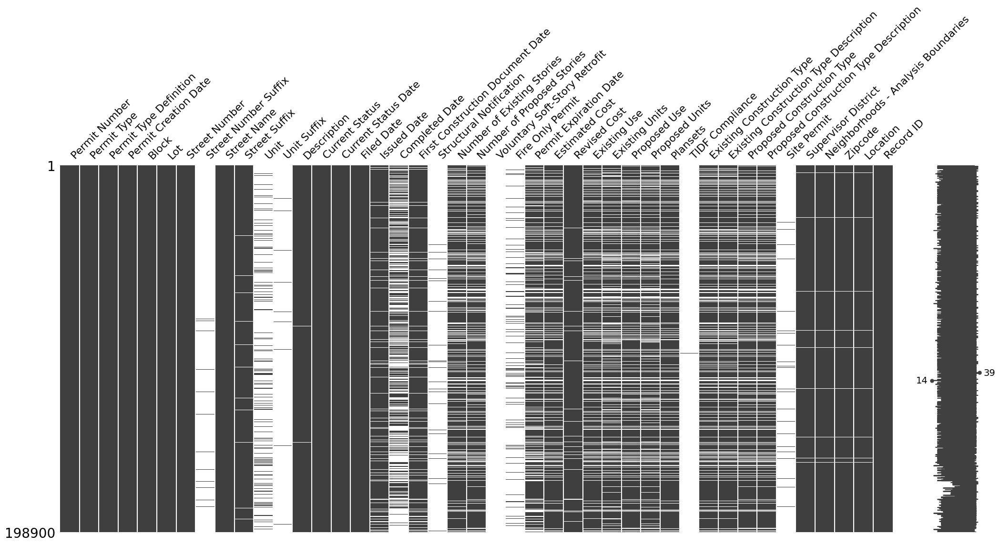

In [5]:
msno.matrix(df)

- Create a copy of your DataFrame (call it df_filled_backwards). Use the back fill method to fill in the missing values
- Create a copy of your DataFrame (call it df_filled_forwards). Use the forward fill method to fill in the missing values
- Create a copy of your DataFrame (call it df_filled_linearly). Use the linear fill method to fill in the missing values

In [6]:
df_filled_backwards = df.copy()
df_filled_forwards = df.copy()
df_filled_linearly = df.copy()

In [7]:
df_filled_backwards = df_filled_backwards.fillna(method = 'ffill')
df_filled_backwards = df_filled_backwards.fillna(method= 'bfill')
df_filled_linearly = df_filled_linearly.interpolate(method='linear')

- For the three new dataframes, plot the distribution of both 'Street Number Suffix' and 'Zipcode'

In [8]:
pd.options.plotting.backend = 'plotly'

# Create subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Backward Fill", "Forward Fill", "Linear Fill"))

# Plot distribution of 'Street Number Suffix' and 'Zipcode' for each DataFrame
fig.add_trace(go.Histogram(x=df_filled_backwards['Street Number Suffix']), row=1, col=1)
fig.add_trace(go.Histogram(x=df_filled_backwards['Zipcode']), row=1, col=1)

fig.add_trace(go.Histogram(x=df_filled_forwards['Street Number Suffix']), row=2, col=1)
fig.add_trace(go.Histogram(x=df_filled_forwards['Zipcode']), row=2, col=1)

fig.add_trace(go.Histogram(x=df_filled_linearly['Street Number Suffix']), row=3, col=1)
fig.add_trace(go.Histogram(x=df_filled_linearly['Zipcode']), row=3, col=1)

# Update subplot layout
fig.update_layout(height=800, showlegend=False)

# Show the plot
fig.show()

#### MORE EXAMPLES

In [11]:
data1 = "https://aicore-files.s3.amazonaws.com/Data-Eng/Beijing_PM.csv" 
data2 = "https://aicore-files.s3.amazonaws.com/Data-Eng/datasets_228_482_diabetes.csv"
data3 = "https://aicore-files.s3.amazonaws.com/Data-Eng/imports-85.data"

In [18]:
auto_df = pd.read_csv(data3)
auto_df.head()

,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.60,...,130,mpfi,3.47,2.68,9.00,111,5000,21,27,13495
0,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
1,1,?,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
2,2,164,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
3,2,164,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450
4,2,?,audi,gas,std,two,sedan,fwd,front,99.8,...,136,mpfi,3.19,3.40,8.5,110,5500,19,25,15250


loading the dataframe correctly with the correct columns


In [24]:
names = ["symboling", "normalized-losses", "make", "fuel-type", "aspiration", "num-of-doors", "body-style", "drive-wheels", "engine-location", "wheel-base", "length", "width", "height", "curb-weight", "engine-type", "num-of-cylinders", "engine-size", "fuel-system", "bore", "stroke", "compression-ratio", "horsepower", "peak-rpm", "city-mpg", "highway-mpg", "price"]
auto_df = pd.read_csv(data3,names=names)
print(auto_df.info())
auto_df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          205 non-null    int64  
 1   normalized-losses  205 non-null    object 
 2   make               205 non-null    object 
 3   fuel-type          205 non-null    object 
 4   aspiration         205 non-null    object 
 5   num-of-doors       205 non-null    object 
 6   body-style         205 non-null    object 
 7   drive-wheels       205 non-null    object 
 8   engine-location    205 non-null    object 
 9   wheel-base         205 non-null    float64
 10  length             205 non-null    float64
 11  width              205 non-null    float64
 12  height             205 non-null    float64
 13  curb-weight        205 non-null    int64  
 14  engine-type        205 non-null    object 
 15  num-of-cylinders   205 non-null    object 
 16  engine-size        205 non

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,?,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450


We can see that there are some "?" in the values, we need to make sure that these are the only values represented to indicate missing values. 
looking at the info table above, there are 205 non null values in all the tables. so it makes sense that "?" is the only value used to represent missing values but before jumping to conclusions, we make 1 final check. 

In [27]:
print(np.sort(auto_df['normalized-losses'].unique()))
print(np.sort(auto_df['stroke'].unique()))

['101' '102' '103' '104' '106' '107' '108' '110' '113' '115' '118' '119'
 '121' '122' '125' '128' '129' '134' '137' '142' '145' '148' '150' '153'
 '154' '158' '161' '164' '168' '186' '188' '192' '194' '197' '231' '256'
 '65' '74' '77' '78' '81' '83' '85' '87' '89' '90' '91' '93' '94' '95'
 '98' '?']
['2.07' '2.19' '2.36' '2.64' '2.68' '2.76' '2.80' '2.87' '2.90' '3.03'
 '3.07' '3.08' '3.10' '3.11' '3.12' '3.15' '3.16' '3.19' '3.21' '3.23'
 '3.27' '3.29' '3.35' '3.39' '3.40' '3.41' '3.46' '3.47' '3.50' '3.52'
 '3.54' '3.58' '3.64' '3.86' '3.90' '4.17' '?']


We can see, that the only unique value, except from "?" are the numbers, now, we'll load the df correctly and replace "?" with np.nan

In [28]:
auto_df = pd.read_csv(data3, header=None, names=names, na_values="?")
print(auto_df.info())
auto_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          205 non-null    int64  
 1   normalized-losses  164 non-null    float64
 2   make               205 non-null    object 
 3   fuel-type          205 non-null    object 
 4   aspiration         205 non-null    object 
 5   num-of-doors       203 non-null    object 
 6   body-style         205 non-null    object 
 7   drive-wheels       205 non-null    object 
 8   engine-location    205 non-null    object 
 9   wheel-base         205 non-null    float64
 10  length             205 non-null    float64
 11  width              205 non-null    float64
 12  height             205 non-null    float64
 13  curb-weight        205 non-null    int64  
 14  engine-type        205 non-null    object 
 15  num-of-cylinders   205 non-null    object 
 16  engine-size        205 non

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,NaN,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,13495.0
1,3,NaN,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,16500.0
2,1,NaN,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154.0,5000.0,19,26,16500.0
3,2,164.0,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102.0,5500.0,24,30,13950.0
4,2,164.0,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115.0,5500.0,18,22,17450.0


### Now Lets load the data set 2 correctly

In [41]:
pima_df = pd.read_csv(data2)
pima_df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


inspecting the data

In [30]:
print(pima_df.info())
pima_df['SkinThickness'].unique()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB
None


array([35, 29,  0, 23, 32, 45, 19, 47, 38, 30, 41, 33, 26, 15, 36, 11, 31,
       37, 42, 25, 18, 24, 39, 27, 21, 34, 10, 60, 13, 20, 22, 28, 54, 40,
       51, 56, 14, 17, 50, 44, 12, 46, 16,  7, 52, 43, 48,  8, 49, 63, 99],
      dtype=int64)

looking at the data, i can infer that the value used to represent the missing value is 0 because there cannot be a person with skinthickness 0, however in the column pregnancies it is possible to have 0 pregnancices. so we need to take our problematic columns and replace them with np.nan 

In [32]:
pima_df.describe()
#to check which columns are the problematic ones

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


The un-problematic columns seem to be pregnancies as they can be 0 while diabetespedigree is also unproblematic as the min is not 0, same for age 

In [33]:
#counting how many 0 in the problematic cols
questionable_columns = ["BloodPressure", "Glucose", "SkinThickness", "Insulin", "BMI"]
zero_counts = {col: 0 for col in questionable_columns}
for col in questionable_columns:
    zero_counts[col] = pima_df[col][pima_df[col] == 0].count()
    
print(zero_counts)

{'BloodPressure': 35, 'Glucose': 5, 'SkinThickness': 227, 'Insulin': 374, 'BMI': 11}


We can also depict this data visually, so its better for us to understand and better for us to explain to anyone

In [36]:
import plotly.express as px
fig = px.histogram(pima_df, "BloodPressure")
fig2 = px.histogram(pima_df,"Insulin")
fig.show()
fig2.show()

### now we just need to replace the 0's in problematic columns with np.nan

In [43]:
pima_df[questionable_columns] = pima_df[questionable_columns].replace(0,np.nan)
pima_df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,763.000000,733.000000,541.000000,394.000000,757.000000,768.000000,768.000000,768.000000
mean,3.845052,121.686763,72.405184,29.153420,155.548223,32.457464,0.471876,33.240885,0.348958
std,3.369578,30.535641,12.382158,10.476982,118.775855,6.924988,0.331329,11.760232,0.476951
min,0.000000,44.000000,24.000000,7.000000,14.000000,18.200000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,64.000000,22.000000,76.250000,27.500000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,29.000000,125.000000,32.300000,0.372500,29.000000,0.000000
75%,6.000000,141.000000,80.000000,36.000000,190.000000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


### missing data calculation
It can be valuable to know how much data is missing

In [44]:
auto_df.isna() #we can also use .isnull()

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
201,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
202,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
203,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [48]:
#we can do sum and % too
print(auto_df.isna().sum())
print("\n")
print(auto_df.isna().mean()*100)

symboling             0
normalized-losses    41
make                  0
fuel-type             0
aspiration            0
num-of-doors          2
body-style            0
drive-wheels          0
engine-location       0
wheel-base            0
length                0
width                 0
height                0
curb-weight           0
engine-type           0
num-of-cylinders      0
engine-size           0
fuel-system           0
bore                  4
stroke                4
compression-ratio     0
horsepower            2
peak-rpm              2
city-mpg              0
highway-mpg           0
price                 4
dtype: int64


symboling             0.00000
normalized-losses    20.00000
make                  0.00000
fuel-type             0.00000
aspiration            0.00000
num-of-doors          0.97561
body-style            0.00000
drive-wheels          0.00000
engine-location       0.00000
wheel-base            0.00000
length                0.00000
width                 0.00000
h

#### We can use missingno to visualise the missing data

<Axes: >

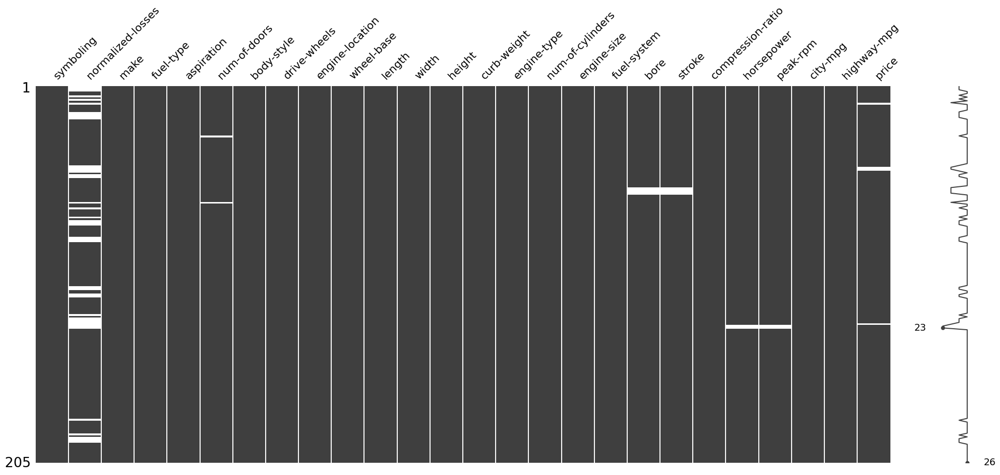

In [49]:
msno.matrix(auto_df)

<Axes: >

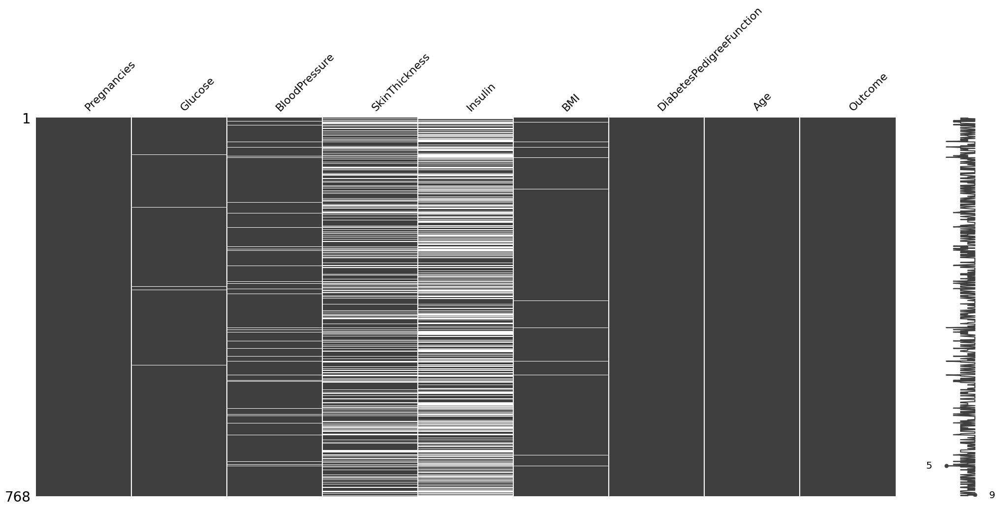

In [50]:
msno.matrix(pima_df)

#### DELETION of data is done in 2 ways - 
1. pairwise deletion where missing values are skipped over
2. listwise deletion where missing rows are deleted (should be done when number of rows dropped << total number of rows)


In [52]:
#pairwise
print("Mean of Glucose using native mean method:", pima_df["Glucose"].mean())
print("Mean of Glucose via manual calculation  :", pima_df["Glucose"].sum() / pima_df["Glucose"].count())
#python automatically deletes using pairwsise, ive verified it above

Mean of Glucose using native mean method: 121.6867627785059
Mean of Glucose via manual calculation  : 121.6867627785059


<Axes: >

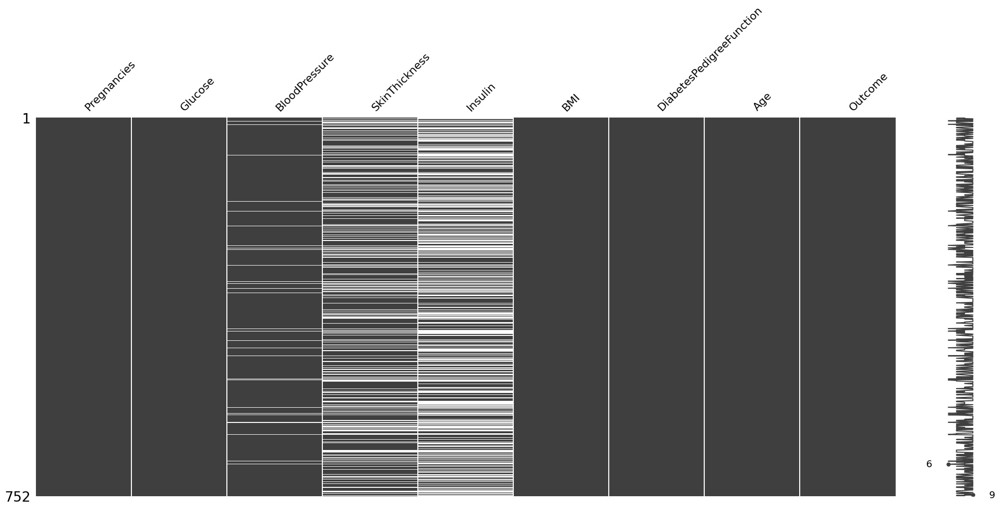

In [54]:
#listwise
pima_df.dropna(subset=['Glucose','BMI'],inplace=True)
msno.matrix(pima_df)
#we have now plotted after dropping the empty values

#### IMPUTATION using averages
Imputation is the act of predicting the missing data, and can be applied to any of the missing data classifications we are working with. In this section, we will look at imputing data using central tendancy measures. We will show why this may not be a great idea, and then introduce ML imputing techniques. Recall the three types of average: Mean, Median and Mode.

The values of these types of imputations are trivial to calculate and we could easily do it ourselves if we wanted to. However, for the sake of introducing you to the API, we will be using skleanr's SimpleImputer.

In [57]:
pima_cols = pima_df.columns
pima_cols

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [58]:
from sklearn.impute import SimpleImputer

mode_imputer = SimpleImputer(strategy="most_frequent")
pima_mode_arr = mode_imputer.fit_transform(pima_df)
pima_mode_df = pd.DataFrame(data=pima_mode_arr, columns=pima_cols)
pima_mode_df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6.0,148.0,72.0,35.0,105.0,33.6,0.627,50.0,1.0
1,1.0,85.0,66.0,29.0,105.0,26.6,0.351,31.0,0.0
2,8.0,183.0,64.0,32.0,105.0,23.3,0.672,32.0,1.0
3,1.0,89.0,66.0,23.0,94.0,28.1,0.167,21.0,0.0
4,0.0,137.0,40.0,35.0,168.0,43.1,2.288,33.0,1.0
...,...,...,...,...,...,...,...,...,...
747,10.0,101.0,76.0,48.0,180.0,32.9,0.171,63.0,0.0
748,2.0,122.0,70.0,27.0,105.0,36.8,0.340,27.0,0.0
749,5.0,121.0,72.0,23.0,112.0,26.2,0.245,30.0,0.0
750,1.0,126.0,60.0,32.0,105.0,30.1,0.349,47.0,1.0


In [60]:
median_imputer = SimpleImputer(strategy="median")
pima_median_arr = median_imputer.fit_transform(pima_df)
pima_median_df = pd.DataFrame(data=pima_median_arr, columns=pima_cols)
pima_median_df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6.0,148.0,72.0,35.0,125.5,33.6,0.627,50.0,1.0
1,1.0,85.0,66.0,29.0,125.5,26.6,0.351,31.0,0.0
2,8.0,183.0,64.0,29.0,125.5,23.3,0.672,32.0,1.0
3,1.0,89.0,66.0,23.0,94.0,28.1,0.167,21.0,0.0
4,0.0,137.0,40.0,35.0,168.0,43.1,2.288,33.0,1.0
...,...,...,...,...,...,...,...,...,...
747,10.0,101.0,76.0,48.0,180.0,32.9,0.171,63.0,0.0
748,2.0,122.0,70.0,27.0,125.5,36.8,0.340,27.0,0.0
749,5.0,121.0,72.0,23.0,112.0,26.2,0.245,30.0,0.0
750,1.0,126.0,60.0,29.0,125.5,30.1,0.349,47.0,1.0


In [61]:
mean_imputer = SimpleImputer(strategy='mean')
pima_mean_arr = mean_imputer.fit_transform(pima_df)
pima_mean_df = pd.DataFrame(data=pima_mean_arr,columns=pima_cols)
pima_mean_df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6.0,148.0,72.0,35.000000,156.056122,33.6,0.627,50.0,1.0
1,1.0,85.0,66.0,29.000000,156.056122,26.6,0.351,31.0,0.0
2,8.0,183.0,64.0,29.172285,156.056122,23.3,0.672,32.0,1.0
3,1.0,89.0,66.0,23.000000,94.000000,28.1,0.167,21.0,0.0
4,0.0,137.0,40.0,35.000000,168.000000,43.1,2.288,33.0,1.0
...,...,...,...,...,...,...,...,...,...
747,10.0,101.0,76.0,48.000000,180.000000,32.9,0.171,63.0,0.0
748,2.0,122.0,70.0,27.000000,156.056122,36.8,0.340,27.0,0.0
749,5.0,121.0,72.0,23.000000,112.000000,26.2,0.245,30.0,0.0
750,1.0,126.0,60.0,29.172285,156.056122,30.1,0.349,47.0,1.0


Central tendancy imputations should be avoided because they reduce the variance of the data, leading to a higher bias in the data. Perhaps more intuitively, these types of imputations will not consider any of the other variable relationships in your data. We can easily see this with visualisations

In [62]:
nulls = (pima_df["SkinThickness"].isnull() + pima_df["BMI"].isnull()).astype("int")
px.scatter(pima_mean_df, x="SkinThickness", y="BMI", title="SkinThickness vs BMI (Mean Imputation)",
           color=nulls)

### Plotting all 3 together

In [63]:
from plotly.subplots import make_subplots

fig_mean = px.scatter(pima_mean_df, x="SkinThickness", y="BMI", color=nulls)

fig_median = px.scatter(pima_median_df, x="SkinThickness", y="BMI", color=nulls)

fig_mode = px.scatter(pima_mode_df, x="SkinThickness", y="BMI", color=nulls)

fig = make_subplots(rows=1, cols=3, shared_xaxes=False, subplot_titles=("Mean Imputation","Median Imputation", "Mode Imputation"))
fig.add_trace(fig_mean['data'][0], row=1, col=1)
fig.add_trace(fig_median['data'][0], row=1, col=2)
fig.add_trace(fig_mode['data'][0], row=1, col=3)
fig.update_layout(title="SkinThickness vs BMI (Imputations)")
fig.show()

MICE - Multivariate Imputation by Chained Equations
We will cover three types algorithms here which have popular use: Nearest neighbours imputation, tree based imputation and regression based imputation. These methods work by building models for a feature based on the other features of the data.

In [64]:
from sklearn.impute import KNNImputer

# default arguments are:
# n_neighbors = 5
# weights = "uniform"
knn_impute = KNNImputer(n_neighbors=3, weights="distance")
pima_knn_arr = knn_impute.fit_transform(pima_df)
pima_knn_df = pd.DataFrame(data=pima_knn_arr, columns=pima_cols)

fig_knn = px.scatter(pima_knn_df, x="SkinThickness", y="BMI", title="SkinThickness vs BMI (KNN Imputation)",
           color=nulls)
fig_knn

In [67]:
# IterativeImputer is an experimental feature in sklearn, so we need to enable it prior to using it
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

regression_impute = IterativeImputer(sample_posterior=True)
pima_regression_arr = regression_impute.fit_transform(pima_df)
pima_regression_df = pd.DataFrame(data=pima_regression_arr, columns=pima_cols)

fig_br = px.scatter(pima_regression_df, x="SkinThickness", y="BMI", title="SkinThickness vs BMI (Regression Imputation)",
           color=nulls)
fig_br

In [74]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import IterativeImputer
# Impute the missing values using RandomForestRegressor and IterativeImputer
regressor = RandomForestRegressor()
tree_based_impute = IterativeImputer(estimator=regressor)
pima_tree_arr = tree_based_impute.fit_transform(pima_df)
pima_tree_df = pd.DataFrame(data=pima_tree_arr, columns=pima_cols)

fig_tree = px.scatter(pima_tree_df, x="SkinThickness",y="BMI",title="SkinThickness vs BMI (Tree Based Imputation)",color=nulls)
fig_tree

c:\Users\Anany\miniconda3\lib\site-packages\sklearn\impute\_iterative.py:785: ConvergenceWarning:

[IterativeImputer] Early stopping criterion not reached.



### Plotting all 3 together

In [76]:
fig = make_subplots(rows=1, cols=3, shared_xaxes=False, subplot_titles=("KNN Imputation", "BR Regression Imputation", "RF Regression Imputation"))
fig.add_trace(fig_knn['data'][0], row=1, col=1)
fig.add_trace(fig_br['data'][0], row=1, col=2)
fig.add_trace(fig_tree['data'][0], row=1, col=3)
fig.update_layout(title="SkinThickness vs BMI (Regression Imputations)")
fig.show()

### Time series imputation with datset1 using bfill,ffill,linear interpolation,quad interpolation, nearest interpolation

In [78]:
#loading dataset1 with the date column as index
pm_df_org = pd.read_csv(data1, index_col="Date", parse_dates=True, infer_datetime_format=True)

In [80]:
pm_df = pm_df_org[:400000]
pm_df = pm_df.loc[~pm_df.index.duplicated(keep='last')]
pm_df = pm_df.sort_index(axis=0)
pm_df

,City,Country,Season,PM2.5 concentration (ug/m^3),Dew Point (Fahrenheit),Temperature (Fahrenheit),Humidity (%),Pressure (hPa),Wind Direction,Wind Speed (m/s),"Precipitation (mm, hourly)","Precipitation (mm, Cumulated)"
Date,,,,,,,,,,,,
2013-03-01 00:00:00,Beijing,China,Winter,5.0,-6.52,32.0,NaN,1024.0,NNW,5.7,0.0,NaN
2013-03-01 01:00:00,Beijing,China,Winter,8.0,-7.78,32.0,NaN,1025.0,NW,3.9,0.0,NaN
2013-03-01 02:00:00,Beijing,China,Winter,3.0,-12.28,30.2,NaN,1025.0,NNW,5.3,0.0,NaN
2013-03-01 03:00:00,Beijing,China,Winter,5.0,-13.90,30.2,NaN,1026.0,N,4.9,0.0,NaN
2013-03-01 04:00:00,Beijing,China,Winter,5.0,-12.10,30.2,NaN,1027.0,NNW,3.2,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2017-02-28 19:00:00,Beijing,China,Winter,16.0,2.84,53.6,NaN,1013.0,NW,2.4,0.0,NaN
2017-02-28 20:00:00,Beijing,China,Winter,18.0,4.82,51.8,NaN,1013.0,WNW,0.9,0.0,NaN
2017-02-28 21:00:00,Beijing,China,Winter,23.0,8.06,50.0,NaN,1014.0,NW,1.1,0.0,NaN


In [83]:
#checking null values
pm_df.isna().mean()*100

City                               0.000000
Country                            0.000000
Season                             0.000000
PM2.5 concentration (ug/m^3)       0.000000
Dew Point (Fahrenheit)             0.057179
Temperature (Fahrenheit)           0.057179
Humidity (%)                     100.000000
Pressure (hPa)                     0.057179
Wind Direction                     0.225856
Wind Speed (m/s)                   0.040025
Precipitation (mm, hourly)         0.057179
Precipitation (mm, Cumulated)    100.000000
dtype: float64

In [84]:
# Renaming columns so they're easier to refer to
pm_cols = ["city", "country", "season", "pm25", "dew_point", "temperature", "humidity", "pressure", "wind_direction", "wind_speed", "precipitation_hourly", "preciptiation_cum"]
pm_df.columns = pm_cols
pm_df.head()

,city,country,season,pm25,dew_point,temperature,humidity,pressure,wind_direction,wind_speed,precipitation_hourly,preciptiation_cum
Date,,,,,,,,,,,,
2013-03-01 00:00:00,Beijing,China,Winter,5.0,-6.52,32.0,NaN,1024.0,NNW,5.7,0.0,NaN
2013-03-01 01:00:00,Beijing,China,Winter,8.0,-7.78,32.0,NaN,1025.0,NW,3.9,0.0,NaN
2013-03-01 02:00:00,Beijing,China,Winter,3.0,-12.28,30.2,NaN,1025.0,NNW,5.3,0.0,NaN
2013-03-01 03:00:00,Beijing,China,Winter,5.0,-13.90,30.2,NaN,1026.0,N,4.9,0.0,NaN
2013-03-01 04:00:00,Beijing,China,Winter,5.0,-12.10,30.2,NaN,1027.0,NNW,3.2,0.0,NaN


In [92]:
#using the range 31230 to 31245
pm_ffill_df = pm_df.fillna(method="ffill")
print('ffill \n',pm_ffill_df["wind_speed"][31230:31245])

pm_bfill_df = pm_df.fillna(method="bfill")
print('bfill \n',pm_bfill_df["wind_speed"][31230:31245])

pm_linear_df = pm_df.interpolate(method="linear")
print('linear \n',pm_linear_df["wind_speed"][31230:31245])

pm_quad_df = pm_df.interpolate(method='quadratic')
print('quad \n',pm_quad_df["wind_speed"][31230:31245])

pm_nearest_df = pm_df.interpolate(method='nearest')
print('nearest \n',pm_nearest_df['wind_speed'][31230:31245])

print('none \n',pm_df["wind_speed"][31230:31245])

ffill 
 Date
2016-09-25 13:00:00    2.0
2016-09-25 14:00:00    0.6
2016-09-25 15:00:00    2.1
2016-09-25 16:00:00    1.3
2016-09-25 17:00:00    1.3
2016-09-25 18:00:00    1.3
2016-09-25 19:00:00    1.3
2016-09-25 20:00:00    1.3
2016-09-25 21:00:00    1.3
2016-09-25 22:00:00    1.3
2016-09-25 23:00:00    1.3
2016-09-26 00:00:00    2.4
2016-09-26 01:00:00    1.9
2016-09-26 02:00:00    0.6
2016-09-26 03:00:00    1.1
Name: wind_speed, dtype: float64
bfill 
 Date
2016-09-25 13:00:00    2.0
2016-09-25 14:00:00    0.6
2016-09-25 15:00:00    2.1
2016-09-25 16:00:00    1.3
2016-09-25 17:00:00    1.3
2016-09-25 18:00:00    1.3
2016-09-25 19:00:00    2.4
2016-09-25 20:00:00    2.4
2016-09-25 21:00:00    2.4
2016-09-25 22:00:00    2.4
2016-09-25 23:00:00    2.4
2016-09-26 00:00:00    2.4
2016-09-26 01:00:00    1.9
2016-09-26 02:00:00    0.6
2016-09-26 03:00:00    1.1
Name: wind_speed, dtype: float64
linear 
 Date
2016-09-25 13:00:00    2.000000
2016-09-25 14:00:00    0.600000
2016-09-25 15:00:00 

In [93]:
pd.options.plotting.backend = 'plotly'

fig = make_subplots(rows=6, cols=1, shared_xaxes=False, subplot_titles=("None", "Ffill Interpoloation", "Bfill Interpoloation", "Linear Interpoloation", "Nearest Interpoloation", "Quadratic Interpoloation"))

default = pm_df["wind_speed"][31230:31245]

fig_none = default.plot()
fig.add_trace(fig_none["data"][0], row=1, col=1)

figs_list = [pm_ffill_df, pm_bfill_df, pm_linear_df, pm_nearest_df, pm_quad_df]
for i, to_fig in enumerate(figs_list):
    fig_ = to_fig["wind_speed"][31230:31245].plot(color_discrete_sequence=["red"])
    fig_.add_trace(px.line(pm_df["wind_speed"][31230:31245]).data[0])
    
    fig.add_trace(fig_["data"][0], row=i+2, col=1)
    fig.add_trace(fig_["data"][1], row=i+2, col=1)

fig.update_layout(title="Wind Speed Interpolations", width=np.inf, height=1600, showlegend=False)
fig.update_traces(mode='markers+lines')
fig.show()

# fig = pm_df.interpolate(method="quadratic")["wind_speed"][31230:31245].plot()
# fig.add_trace(px.line(pm_df["wind_speed"][31230:31245], color_discrete_sequence=["red"]).data[0])
# fig.show()

Imputing categorical values

In [94]:
from sklearn.preprocessing import OrdinalEncoder
knn_impute = KNNImputer(n_neighbors=3, weights="distance")

# We will drop city and country because these are categorical variables which have all their values present
# We will keep season even though it has all the values present (just to demonstrate the process over multiple categorical variables)
# We will drop humidity and precipitation_cum as these features are fully NaN
pm_to_impute_cols = ["season", "pm25", "dew_point", "temperature", "pressure", "wind_direction", "wind_speed", "precipitation_hourly"]
pm_to_impute_df = pm_df[pm_to_impute_cols]
cat_cols = ["season", "wind_direction"]

# key: col, value: list of tuples
category_dict_encode = {}
category_dict_decode = {}
for col in cat_cols:
    pm_to_impute_df[col] = pm_to_impute_df[col].astype("category")
    categories = pm_to_impute_df[col].cat.categories
    
    col_cat_dict = dict(enumerate(categories))
    print("Column, Category dict:", col_cat_dict)
    category_dict_decode[col] = col_cat_dict
    
    col_cat_dict = {v:k for k,v in col_cat_dict.items()}
    print("Inverted Column, Category dict:", col_cat_dict)
    category_dict_encode[col] = col_cat_dict

print()
print("Category dict ENCODE:", category_dict_encode)
print("Category dict DECODE:", category_dict_decode)
pm_to_impute_df.replace(category_dict_encode, inplace=True)
pm_to_impute_df

Column, Category dict: {0: 'Winter'}
Inverted Column, Category dict: {'Winter': 0}
Column, Category dict: {0: 'E', 1: 'ENE', 2: 'ESE', 3: 'N', 4: 'NE', 5: 'NNE', 6: 'NNW', 7: 'NW', 8: 'S', 9: 'SE', 10: 'SSE', 11: 'SSW', 12: 'SW', 13: 'W', 14: 'WNW', 15: 'WSW'}
Inverted Column, Category dict: {'E': 0, 'ENE': 1, 'ESE': 2, 'N': 3, 'NE': 4, 'NNE': 5, 'NNW': 6, 'NW': 7, 'S': 8, 'SE': 9, 'SSE': 10, 'SSW': 11, 'SW': 12, 'W': 13, 'WNW': 14, 'WSW': 15}

Category dict ENCODE: {'season': {'Winter': 0}, 'wind_direction': {'E': 0, 'ENE': 1, 'ESE': 2, 'N': 3, 'NE': 4, 'NNE': 5, 'NNW': 6, 'NW': 7, 'S': 8, 'SE': 9, 'SSE': 10, 'SSW': 11, 'SW': 12, 'W': 13, 'WNW': 14, 'WSW': 15}}
Category dict DECODE: {'season': {0: 'Winter'}, 'wind_direction': {0: 'E', 1: 'ENE', 2: 'ESE', 3: 'N', 4: 'NE', 5: 'NNE', 6: 'NNW', 7: 'NW', 8: 'S', 9: 'SE', 10: 'SSE', 11: 'SSW', 12: 'SW', 13: 'W', 14: 'WNW', 15: 'WSW'}}


C:\Users\Anany\AppData\Local\Temp\ipykernel_2792\589704478.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Anany\AppData\Local\Temp\ipykernel_2792\589704478.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Anany\AppData\Local\Temp\ipykernel_2792\589704478.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

,season,pm25,dew_point,temperature,pressure,wind_direction,wind_speed,precipitation_hourly
Date,,,,,,,,
2013-03-01 00:00:00,0,5.0,-6.52,32.0,1024.0,6,5.7,0.0
2013-03-01 01:00:00,0,8.0,-7.78,32.0,1025.0,7,3.9,0.0
2013-03-01 02:00:00,0,3.0,-12.28,30.2,1025.0,6,5.3,0.0
2013-03-01 03:00:00,0,5.0,-13.90,30.2,1026.0,3,4.9,0.0
2013-03-01 04:00:00,0,5.0,-12.10,30.2,1027.0,6,3.2,0.0
...,...,...,...,...,...,...,...,...
2017-02-28 19:00:00,0,16.0,2.84,53.6,1013.0,7,2.4,0.0
2017-02-28 20:00:00,0,18.0,4.82,51.8,1013.0,14,0.9,0.0
2017-02-28 21:00:00,0,23.0,8.06,50.0,1014.0,7,1.1,0.0


In [95]:
knn_pm_arr = knn_impute.fit_transform(pm_to_impute_df)
knn_pm_df = pd.DataFrame(knn_pm_arr, columns = pm_to_impute_cols)
knn_pm_df[31230:31245]

,season,pm25,dew_point,temperature,pressure,wind_direction,wind_speed,precipitation_hourly
31230,0.0,173.0,66.3800,77.000,1010.000000,5.000000,2.000000,0.0
31231,0.0,163.0,64.7600,78.800,1010.000000,4.000000,0.600000,0.0
31232,0.0,168.0,64.5800,78.800,1009.000000,4.000000,2.100000,0.0
31233,0.0,189.0,65.1200,80.600,1009.000000,7.000000,1.300000,0.0
31234,0.0,200.0,66.3800,78.800,1009.000000,4.000000,1.300000,0.0
31235,0.0,176.0,67.2800,78.800,1009.000000,4.000000,1.300000,0.0
31236,0.0,183.0,53.5400,63.800,1004.666667,2.000000,1.233333,0.0
31237,0.0,143.0,53.4200,76.400,1009.666667,8.333333,2.100000,0.0
31238,0.0,106.0,18.6200,47.000,1008.333333,9.333333,1.566667,0.0
31239,0.0,95.0,27.4400,46.400,1016.666667,4.666667,3.033333,0.0


In [96]:
for col in cat_cols:
    knn_pm_df[col] = knn_pm_df[col].round()
knn_pm_df.index = pm_df.index
knn_pm_df[31230:31245]

,season,pm25,dew_point,temperature,pressure,wind_direction,wind_speed,precipitation_hourly
Date,,,,,,,,
2016-09-25 13:00:00,0.0,173.0,66.3800,77.000,1010.000000,5.0,2.000000,0.0
2016-09-25 14:00:00,0.0,163.0,64.7600,78.800,1010.000000,4.0,0.600000,0.0
2016-09-25 15:00:00,0.0,168.0,64.5800,78.800,1009.000000,4.0,2.100000,0.0
2016-09-25 16:00:00,0.0,189.0,65.1200,80.600,1009.000000,7.0,1.300000,0.0
2016-09-25 17:00:00,0.0,200.0,66.3800,78.800,1009.000000,4.0,1.300000,0.0
2016-09-25 18:00:00,0.0,176.0,67.2800,78.800,1009.000000,4.0,1.300000,0.0
2016-09-25 19:00:00,0.0,183.0,53.5400,63.800,1004.666667,2.0,1.233333,0.0
2016-09-25 20:00:00,0.0,143.0,53.4200,76.400,1009.666667,8.0,2.100000,0.0
2016-09-25 21:00:00,0.0,106.0,18.6200,47.000,1008.333333,9.0,1.566667,0.0


In [97]:
# In the original dataframe we will only replace the values for the categorical cols we imputed
# We need to map the columns back to their codes
knn_pm_df.replace(category_dict_decode, inplace=True)
knn_pm_df[31230:31245]

,season,pm25,dew_point,temperature,pressure,wind_direction,wind_speed,precipitation_hourly
Date,,,,,,,,
2016-09-25 13:00:00,Winter,173.0,66.3800,77.000,1010.000000,NNE,2.000000,0.0
2016-09-25 14:00:00,Winter,163.0,64.7600,78.800,1010.000000,NE,0.600000,0.0
2016-09-25 15:00:00,Winter,168.0,64.5800,78.800,1009.000000,NE,2.100000,0.0
2016-09-25 16:00:00,Winter,189.0,65.1200,80.600,1009.000000,NW,1.300000,0.0
2016-09-25 17:00:00,Winter,200.0,66.3800,78.800,1009.000000,NE,1.300000,0.0
2016-09-25 18:00:00,Winter,176.0,67.2800,78.800,1009.000000,NE,1.300000,0.0
2016-09-25 19:00:00,Winter,183.0,53.5400,63.800,1004.666667,ESE,1.233333,0.0
2016-09-25 20:00:00,Winter,143.0,53.4200,76.400,1009.666667,S,2.100000,0.0
2016-09-25 21:00:00,Winter,106.0,18.6200,47.000,1008.333333,SE,1.566667,0.0


In [98]:
imputed_cols_df = knn_pm_df[cat_cols]
imputed_cols_df

,season,wind_direction
Date,,
2013-03-01 00:00:00,Winter,NNW
2013-03-01 01:00:00,Winter,NW
2013-03-01 02:00:00,Winter,NNW
2013-03-01 03:00:00,Winter,N
2013-03-01 04:00:00,Winter,NNW
...,...,...
2017-02-28 19:00:00,Winter,NW
2017-02-28 20:00:00,Winter,WNW
2017-02-28 21:00:00,Winter,NW


In [99]:
pm_imputed_df = pm_df.copy(deep=True)
pm_imputed_df.update(knn_pm_df, overwrite=False)
pm_imputed_df[31230:31245]

,city,country,season,pm25,dew_point,temperature,humidity,pressure,wind_direction,wind_speed,precipitation_hourly,preciptiation_cum
Date,,,,,,,,,,,,
2016-09-25 13:00:00,Beijing,China,Winter,173.0,66.3800,77.000,NaN,1010.000000,NNE,2.000000,0.0,NaN
2016-09-25 14:00:00,Beijing,China,Winter,163.0,64.7600,78.800,NaN,1010.000000,NE,0.600000,0.0,NaN
2016-09-25 15:00:00,Beijing,China,Winter,168.0,64.5800,78.800,NaN,1009.000000,NE,2.100000,0.0,NaN
2016-09-25 16:00:00,Beijing,China,Winter,189.0,65.1200,80.600,NaN,1009.000000,NW,1.300000,0.0,NaN
2016-09-25 17:00:00,Beijing,China,Winter,200.0,66.3800,78.800,NaN,1009.000000,NE,1.300000,0.0,NaN
2016-09-25 18:00:00,Beijing,China,Winter,176.0,67.2800,78.800,NaN,1009.000000,NE,1.300000,0.0,NaN
2016-09-25 19:00:00,Beijing,China,Winter,183.0,53.5400,63.800,NaN,1004.666667,ESE,1.233333,0.0,NaN
2016-09-25 20:00:00,Beijing,China,Winter,143.0,53.4200,76.400,NaN,1009.666667,S,2.100000,0.0,NaN
2016-09-25 21:00:00,Beijing,China,Winter,106.0,18.6200,47.000,NaN,1008.333333,SE,1.566667,0.0,NaN


In [100]:
nulls = pm_df["wind_speed"][31230:31245].isnull()
print(nulls)

fig = pm_imputed_df["wind_speed"][31230:31245].plot(color_discrete_sequence=["red"])
fig.add_trace(px.line(pm_df["wind_speed"][31230:31245]).data[0])
fig.update_traces(mode='markers+lines')
fig.update_layout(title="Wind Speed Interpolation (KNN Full DF imputation)")
fig["data"][0]["name"] = "Interpolated"
fig["data"][1]["name"] = "Orignal"
fig.show()

Date
2016-09-25 13:00:00    False
2016-09-25 14:00:00    False
2016-09-25 15:00:00    False
2016-09-25 16:00:00    False
2016-09-25 17:00:00    False
2016-09-25 18:00:00    False
2016-09-25 19:00:00     True
2016-09-25 20:00:00     True
2016-09-25 21:00:00     True
2016-09-25 22:00:00     True
2016-09-25 23:00:00     True
2016-09-26 00:00:00    False
2016-09-26 01:00:00    False
2016-09-26 02:00:00    False
2016-09-26 03:00:00    False
Name: wind_speed, dtype: bool


- need to catch up on numpy broadcasting
- need to catch up on categorical imputation

query order of execution for SQL.
- https://sqlbolt.com/lesson/select_queries_order_of_execution
- https://blog.codinghorror.com/a-visual-explanation-of-sql-joins/
- https://en.wikipedia.org/wiki/Join_(SQL)